# 1. Import Necessary Libraries

In [1]:
import os
import os.path as osp
import copy

import time
import numpy as np
import cv2
from PIL import Image
from tqdm import tqdm

import torch
from torch.utils.data.dataset import Dataset
from torch import nn
from torch.utils.data.dataloader import DataLoader
from torchvision import transforms
from torchvision import models
from torchvision.utils import make_grid
from torchinfo import summary
import torchvision.transforms.functional as F

import albumentations 
from albumentations.pytorch.transforms import ToTensorV2
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay

import random
import json

import polars as pl
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid
import matplotlib.patches as mpatches
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')

plt.style.use('ggplot')
pl.Config().set_tbl_rows(50)
pl.Config().set_tbl_cols(-1)
pl.Config().set_fmt_str_lengths(100)

def seed_everything(seed):
    np.random.seed(seed) 
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    random.seed(seed)

seed_everything(42)

# 2. Exploratory Data Analysis

## 2.1 Read Data and LabelMap

In [2]:
ROOT_DIR = 'Datasets'
TRAIN_IMAGES_DIR = osp.join(ROOT_DIR, 'train_images')
train_df = pl.read_csv(os.path.join(ROOT_DIR, 'train.csv'))

# Create image paths
train_df = train_df.with_columns(
    path=pl.concat_str(pl.lit(f'{TRAIN_IMAGES_DIR}/'), pl.col('image_id'))
)

In [3]:
with open("Datasets/label_num_to_disease_map.json", "r") as f:
    labelmap = json.load(f)
    labelmap = {int(k): v for k, v in labelmap.items()}

print(json.dumps(labelmap, indent=4))

{
    "0": "Cassava Bacterial Blight (CBB)",
    "1": "Cassava Brown Streak Disease (CBSD)",
    "2": "Cassava Green Mottle (CGM)",
    "3": "Cassava Mosaic Disease (CMD)",
    "4": "Healthy"
}


## 2.2 Checking Existence

In [4]:
train_df = train_df.with_columns(
    is_exists=pl.col('path').map_elements(lambda x: osp.exists(x))
)

n_not_exists = train_df.filter(pl.col('is_exists') == False).shape[0]
assert n_not_exists == 0, print(f'There are {n_not_exists} non-exists files')

n_images = train_df.filter(pl.col('is_exists') == True).shape[0]
print(f'Total images: {n_images}')

train_df.head(20)

Total images: 21397


image_id,label,path,is_exists
str,i64,str,bool
"""1000015157.jpg""",0,"""../input/cassava-leaf-disease-classification/train_images/1000015157.jpg""",true
"""1000201771.jpg""",3,"""../input/cassava-leaf-disease-classification/train_images/1000201771.jpg""",true
"""100042118.jpg""",1,"""../input/cassava-leaf-disease-classification/train_images/100042118.jpg""",true
"""1000723321.jpg""",1,"""../input/cassava-leaf-disease-classification/train_images/1000723321.jpg""",true
"""1000812911.jpg""",3,"""../input/cassava-leaf-disease-classification/train_images/1000812911.jpg""",true
"""1000837476.jpg""",3,"""../input/cassava-leaf-disease-classification/train_images/1000837476.jpg""",true
"""1000910826.jpg""",2,"""../input/cassava-leaf-disease-classification/train_images/1000910826.jpg""",true
"""1001320321.jpg""",0,"""../input/cassava-leaf-disease-classification/train_images/1001320321.jpg""",true
"""1001723730.jpg""",4,"""../input/cassava-leaf-disease-classification/train_images/1001723730.jpg""",true


## 2.3 Train-val-test split

In [5]:
val_size = 0.2
test_size = 0.2

val_split = n_images - int(n_images * (test_size + val_size))
test_split = n_images - int(n_images * test_size)

val_df = train_df[val_split:test_split]
test_df = train_df[test_split:]
train_df = train_df[:val_split]

n_train = len(train_df)
n_val = len(val_df)
n_test = len(test_df)

print('Splitted dataset:')
print(f'\t- Training set: {n_train}')
print(f'\t- Validation set: {n_val}')
print(f'\t- Testing set: {n_test}')

Splitted dataset:
	- Training set: 12839
	- Validation set: 4279
	- Testing set: 4279


## 2.3 Number of samples by class

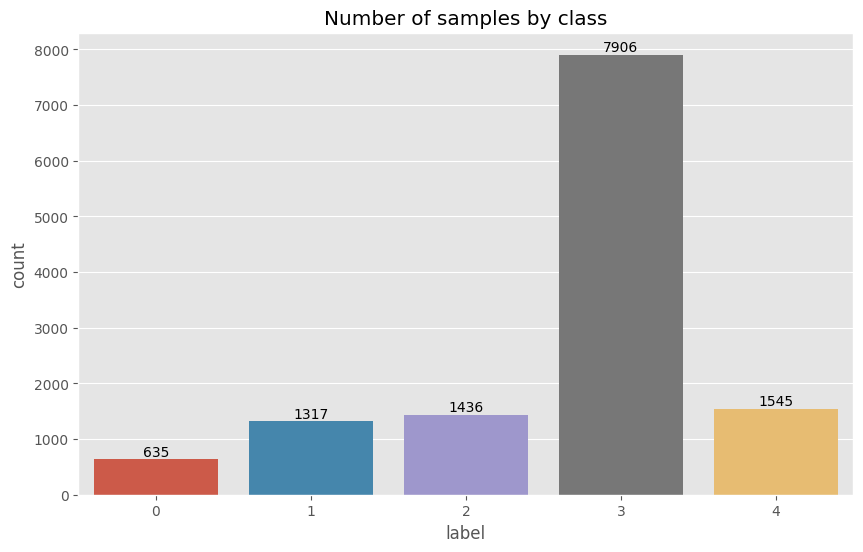

In [6]:
plt.figure(figsize=(10,6))
ax = sns.countplot(x="label", data=train_df.to_pandas())
ax = ax.bar_label(ax.containers[0])

plt.title('Number of samples by class')
plt.show()

## 2.4 Color Histogram Statistics

In [7]:
def stats_color_hist(df: pl.DataFrame, nb_bins=256):
    means = []
    stds = []
    count_r = np.zeros(nb_bins)
    count_g = np.zeros(nb_bins)
    count_b = np.zeros(nb_bins)
    
    paths = df['path']
    n = len(paths)
    
    for i in tqdm(range(n)):
        img = cv2.imread(paths[i])
        means.append(img.mean())
        stds.append(img.std())
        hist_r = np.histogram(img[:, :, 2], bins=nb_bins, range=[0, 255])
        hist_g = np.histogram(img[:, :, 1], bins=nb_bins, range=[0, 255])
        hist_b = np.histogram(img[:, :, 0], bins=nb_bins, range=[0, 255])
        count_r += hist_r[0]
        count_g += hist_g[0]
        count_b += hist_b[0]
        
    means = np.array(means)
    stds = np.array(stds)

    count_r = count_r / n
    count_g = count_g / n
    count_b = count_b / n

    bins = hist_r[1]
    histogram = {
        'r': count_r,
        'g': count_g,
        'b': count_b
    }
    return histogram, bins


In [8]:
# Train-set histogram
hist_train, bins_train = stats_color_hist(train_df)

# Val-set histogram
hist_val, bins_val = stats_color_hist(val_df)

# Test-set histogram
hist_test, bins_test = stats_color_hist(test_df)

100%|██████████| 4279/4279 [03:22<00:00, 21.13it/s]


Overall color histogram of each set

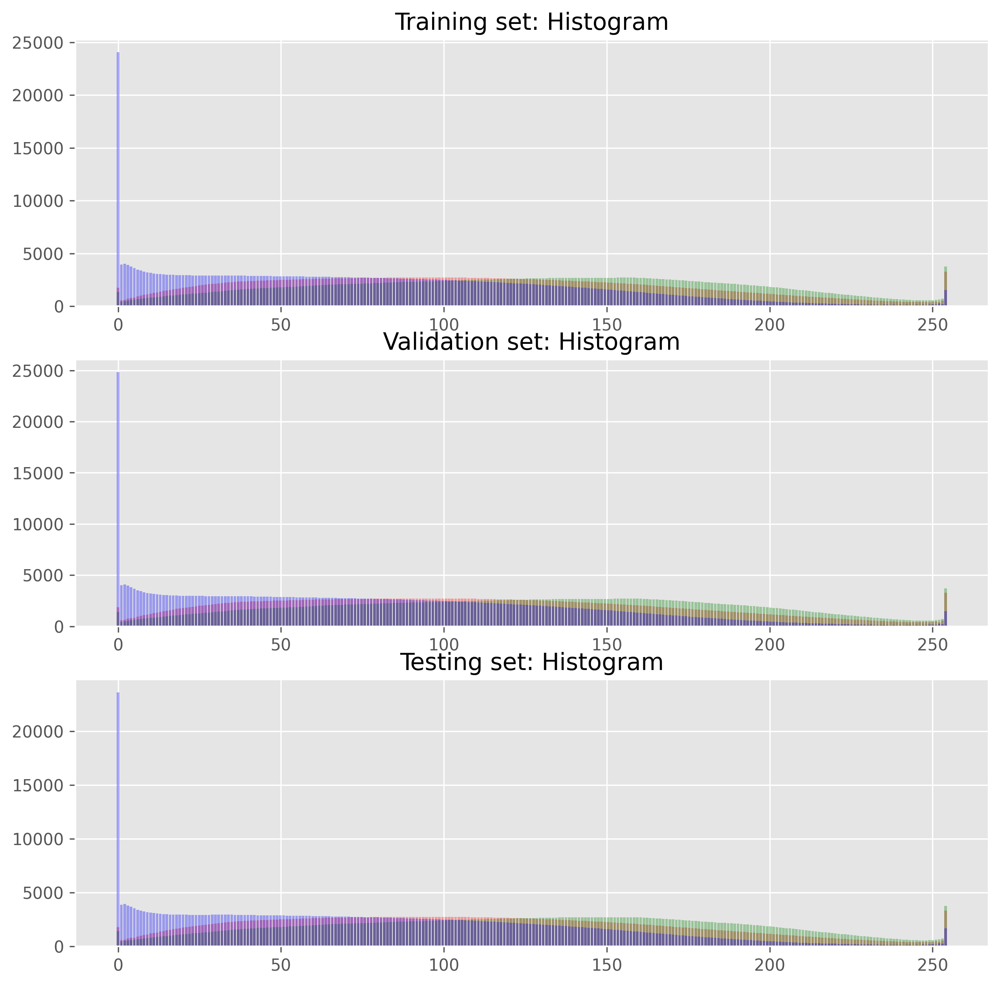

In [9]:
fig, axes = plt.subplots(3, 1, figsize=(10, 10), dpi=300)
axes[0].set_title('Training set: Histogram')
axes[0].bar(bins_train[:-1], hist_train['r'], color='r', alpha=0.33)
axes[0].bar(bins_train[:-1], hist_train['g'], color='g', alpha=0.33)
axes[0].bar(bins_train[:-1], hist_train['b'], color='b', alpha=0.33)

axes[1].set_title('Validation set: Histogram')
axes[1].bar(bins_val[:-1], hist_val['r'], color='r', alpha=0.33)
axes[1].bar(bins_val[:-1], hist_val['g'], color='g', alpha=0.33)
axes[1].bar(bins_val[:-1], hist_val['b'], color='b', alpha=0.33)

axes[2].set_title('Testing set: Histogram')
axes[2].bar(bins_test[:-1], hist_test['r'], color='r', alpha=0.33)
axes[2].bar(bins_test[:-1], hist_test['g'], color='g', alpha=0.33)
axes[2].bar(bins_test[:-1], hist_test['b'], color='b', alpha=0.33)

plt.show()

Closer look of color histogram in the range 0 to 5000 of frequency

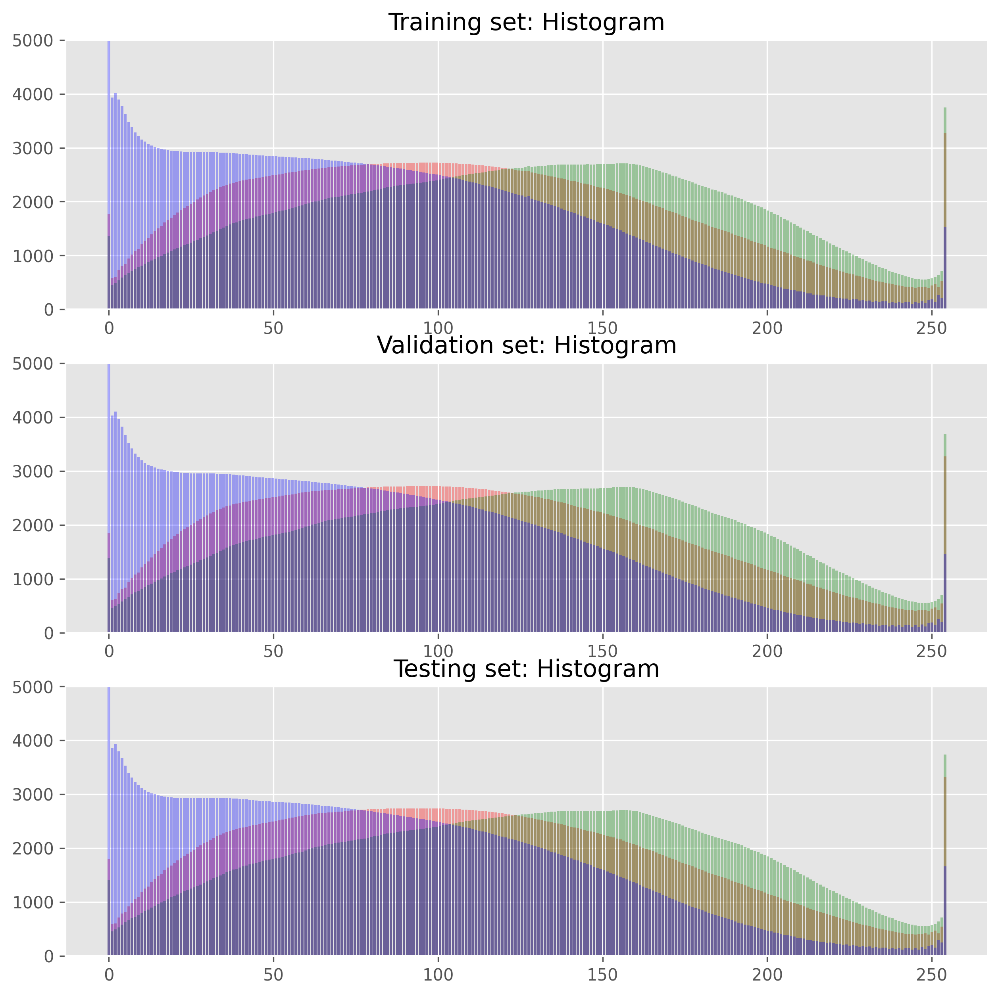

In [10]:
fig, axes = plt.subplots(3, 1, figsize=(10, 10), dpi=300)
axes[0].set_title('Training set: Histogram')
axes[0].bar(bins_train[:-1], hist_train['r'], color='r', alpha=0.33)
axes[0].bar(bins_train[:-1], hist_train['g'], color='g', alpha=0.33)
axes[0].bar(bins_train[:-1], hist_train['b'], color='b', alpha=0.33)
axes[0].set_ylim(0, 5000)

axes[1].set_title('Validation set: Histogram')
axes[1].bar(bins_val[:-1], hist_val['r'], color='r', alpha=0.33)
axes[1].bar(bins_val[:-1], hist_val['g'], color='g', alpha=0.33)
axes[1].bar(bins_val[:-1], hist_val['b'], color='b', alpha=0.33)
axes[1].set_ylim(0, 5000)

axes[2].set_title('Testing set: Histogram')
axes[2].bar(bins_test[:-1], hist_test['r'], color='r', alpha=0.33)
axes[2].bar(bins_test[:-1], hist_test['g'], color='g', alpha=0.33)
axes[2].bar(bins_test[:-1], hist_test['b'], color='b', alpha=0.33)
axes[2].set_ylim(0, 5000)

plt.show()

$\Rightarrow$ Color histograms of three channels of training, validation and testing set are <u>*similar*</u>.

## 2.5 Image shapes

## 2.6 Visualize sample images

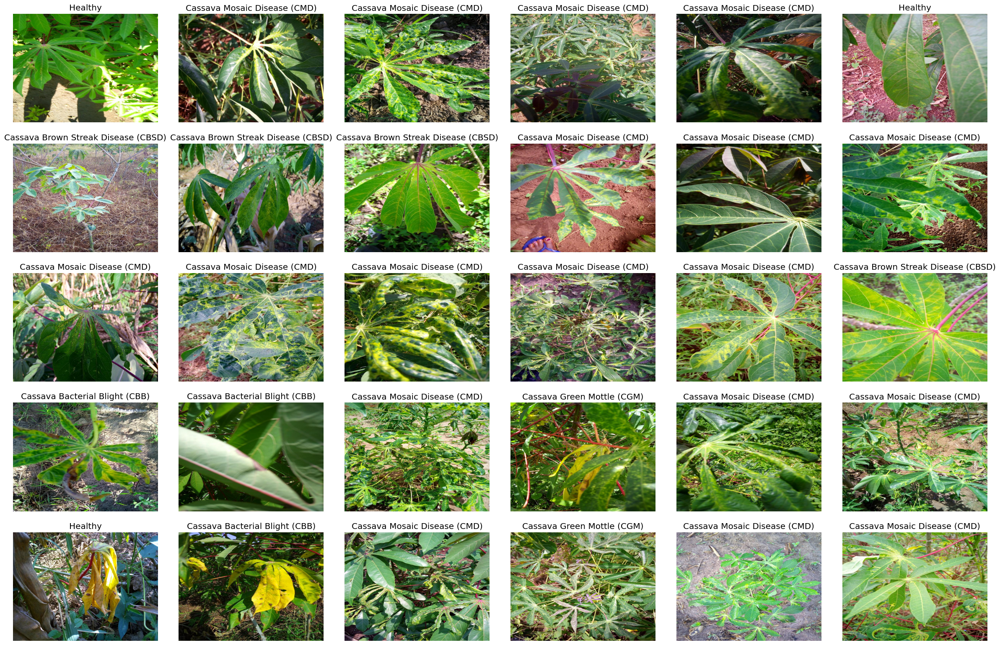

In [11]:
def plot_images(row, col):
    # Create a figure with the desired size
    fig = plt.figure(figsize=(5 * col, 5 * row))

    # Create a grid of subplots
    grid = ImageGrid(fig, 111, nrows_ncols=(row, col), axes_pad=0.5)

    # Sample some data from the train_df dataframe
    sample = train_df.sample(row * col)
    paths = sample['path'].to_list()
    labels = sample['label'].to_list()

    for i, ax in enumerate(grid):
        img = plt.imread(paths[i])
        ax.imshow(img)
        ax.set_title(labelmap[labels[i]])
        ax.axis('off')

    plt.show()

plot_images(5, 6)

# 3. Image Augmentation

## 3.1 Original images

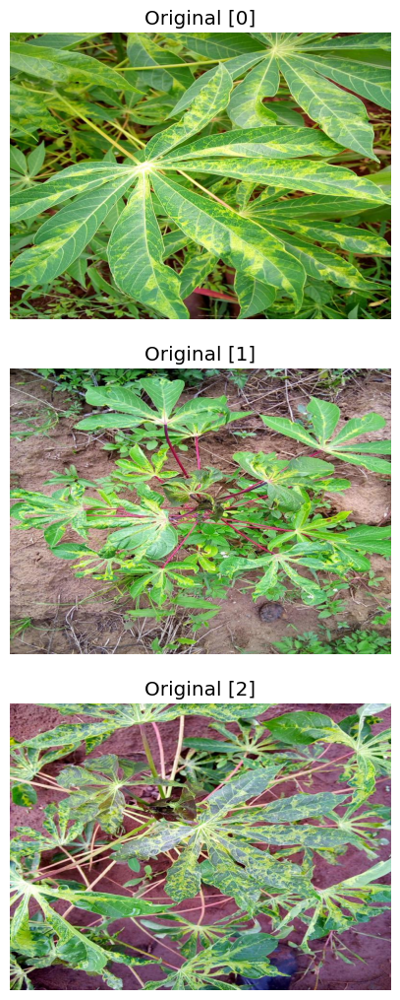

In [12]:
N = 3
fig = plt.figure(figsize=(5, 5 * N))
grid = ImageGrid(fig, 111, nrows_ncols=(N, 1), axes_pad=0.5)
sample = train_df.sample(N)
paths = sample['path'].to_list()
for i, ax in enumerate(grid):
    img = plt.imread(paths[i])
    ax.imshow(img)
    ax.set_title(f'Original [{i}]')
    ax.axis('off')

## 3.2 Vertical Flip

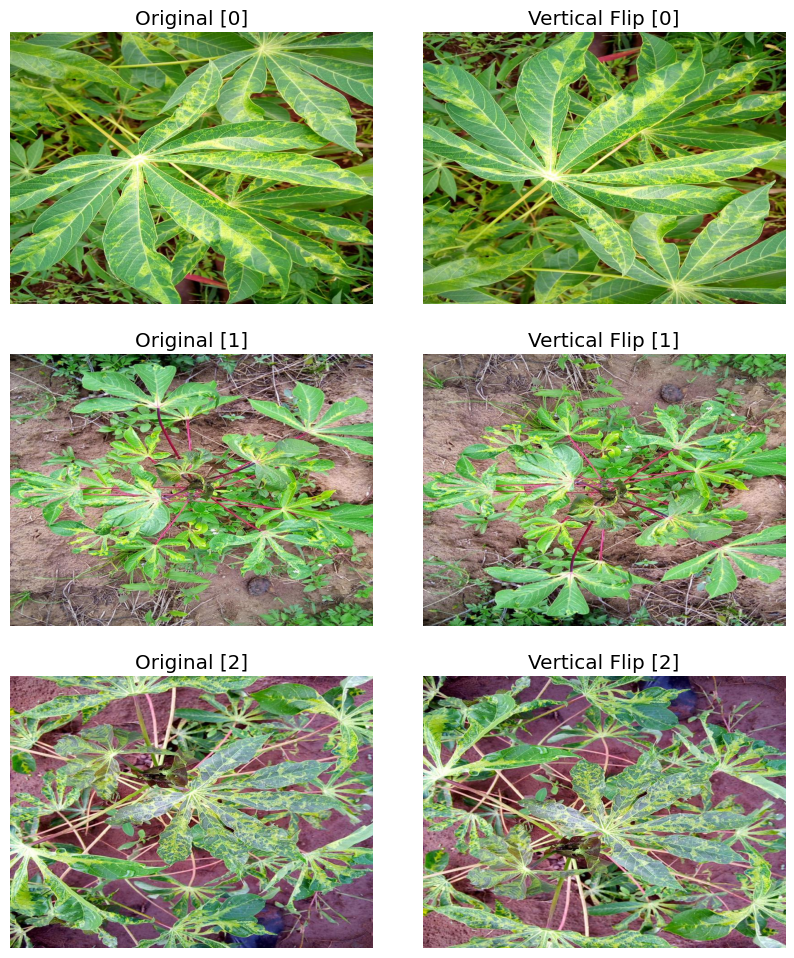

In [13]:
vertical_transform = albumentations.VerticalFlip(p=1)

fig = plt.figure(figsize=(5 * 2, 5 * N))
grid = ImageGrid(fig, 111, nrows_ncols=(N, 2), axes_pad=0.5)
for i, ax in enumerate(grid):
    # Random new sample
    if i % 2 == 0:
        org_img = plt.imread(paths[i // 2])
        img = org_img.copy()
        ax.imshow(img)
        ax.set_title(f'Original [{i // 2}]')
    else:
        img = vertical_transform(image=img)['image']
        ax.imshow(img)
        ax.set_title(f'Vertical Flip [{i // 2}]')
    
    ax.axis('off')

## 3.3 Horizontal Flip

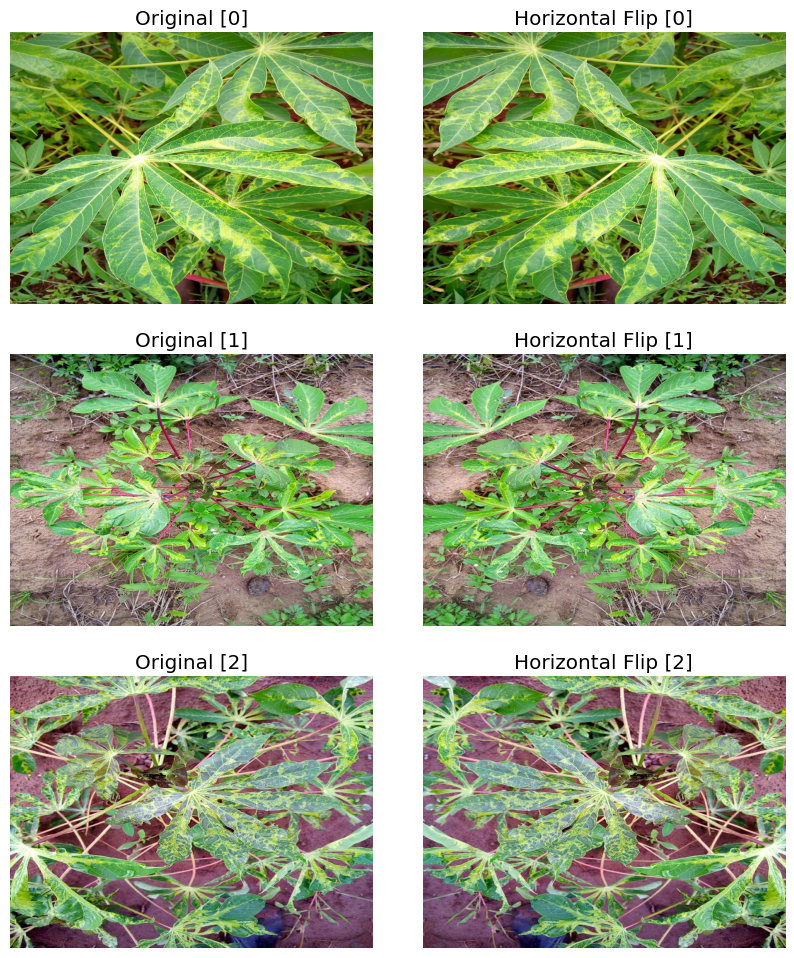

In [14]:
horizontal_transform = albumentations.HorizontalFlip(p=1)

fig = plt.figure(figsize=(5 * 2, 5 * N))
grid = ImageGrid(fig, 111, nrows_ncols=(N, 2), axes_pad=0.5)
for i, ax in enumerate(grid):
    # Random new sample
    if i % 2 == 0:
        org_img = plt.imread(paths[i // 2])
        img = org_img.copy()
        ax.imshow(img)
        ax.set_title(f'Original [{i // 2}]')
    else:
        img = horizontal_transform(image=img)['image']
        ax.imshow(img)
        ax.set_title(f'Horizontal Flip [{i // 2}]')
    
    ax.axis('off')

## 3.4 Random Resized Crop

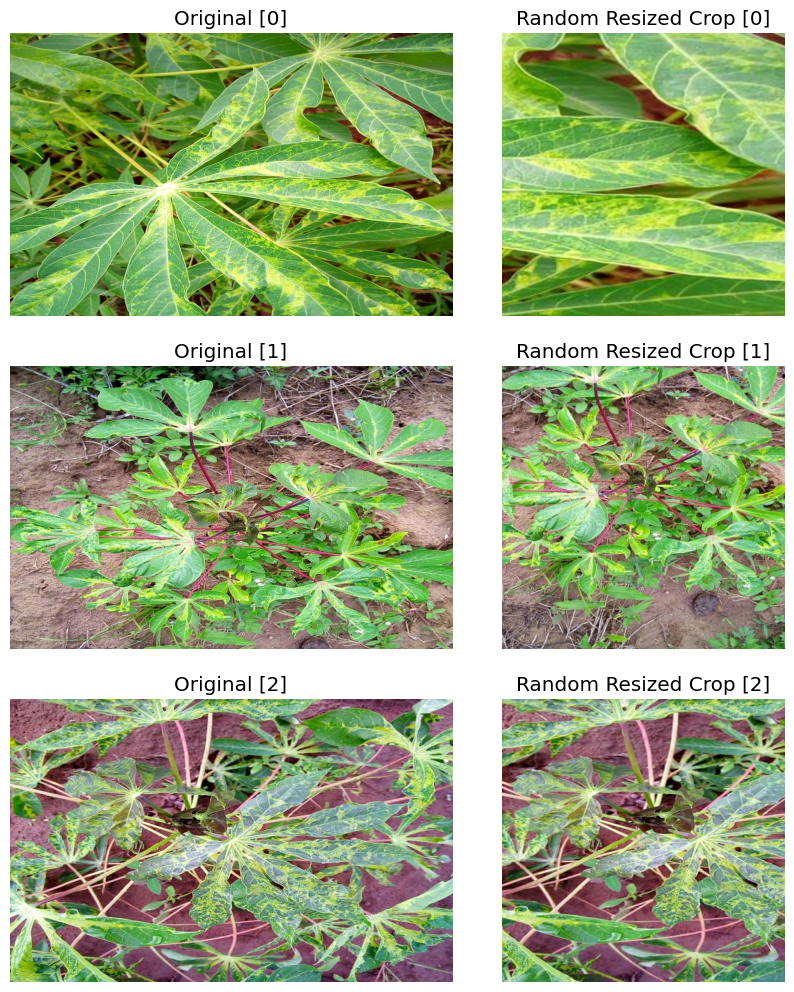

In [15]:
random_crop_transform = albumentations.RandomResizedCrop(width=512, height=512)

fig = plt.figure(figsize=(5 * 2, 5 * N))
grid = ImageGrid(fig, 111, nrows_ncols=(N, 2), axes_pad=0.5)
for i, ax in enumerate(grid):
    # Random new sample
    if i % 2 == 0:
        org_img = plt.imread(paths[i // 2])
        img = org_img.copy()
        ax.imshow(img)
        ax.set_title(f'Original [{i // 2}]')
    else:
        img = random_crop_transform(image=img)['image']
        ax.imshow(img)
        ax.set_title(f'Random Resized Crop [{i // 2}]')
    
    ax.axis('off')

## 3.5 Transpose

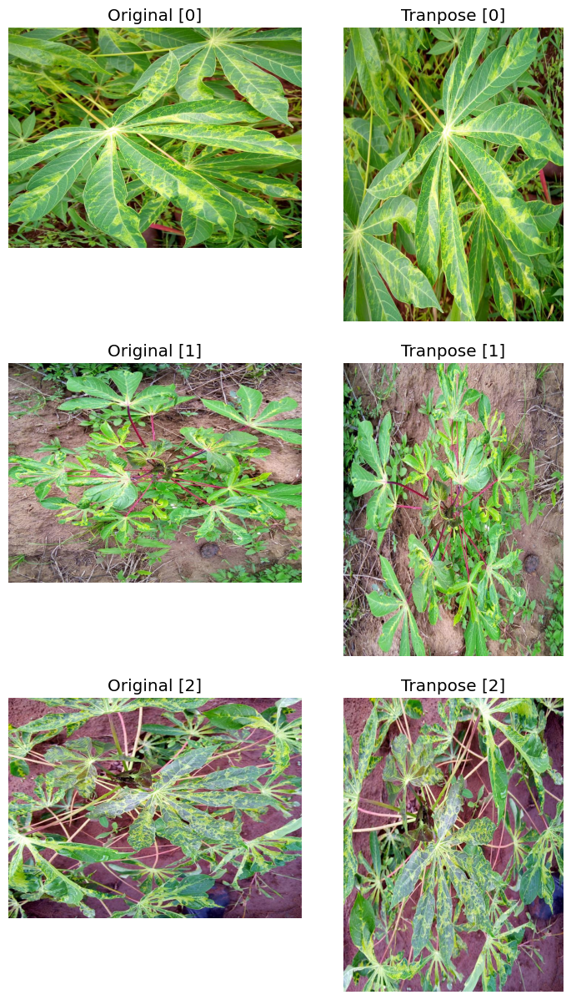

In [16]:
transpose_transform = albumentations.Transpose(p=1)

fig = plt.figure(figsize=(5 * 2, 5 * N))
grid = ImageGrid(fig, 111, nrows_ncols=(N, 2), axes_pad=0.5)
for i, ax in enumerate(grid):
    # Random new sample
    if i % 2 == 0:
        org_img = plt.imread(paths[i // 2])
        img = org_img.copy()
        ax.imshow(img)
        ax.set_title(f'Original [{i // 2}]')
    else:
        img = transpose_transform(image=img)['image']
        ax.imshow(img)
        ax.set_title(f'Tranpose [{i // 2}]')
    
    ax.axis('off')

## 3.6 Shift Scale Rotate

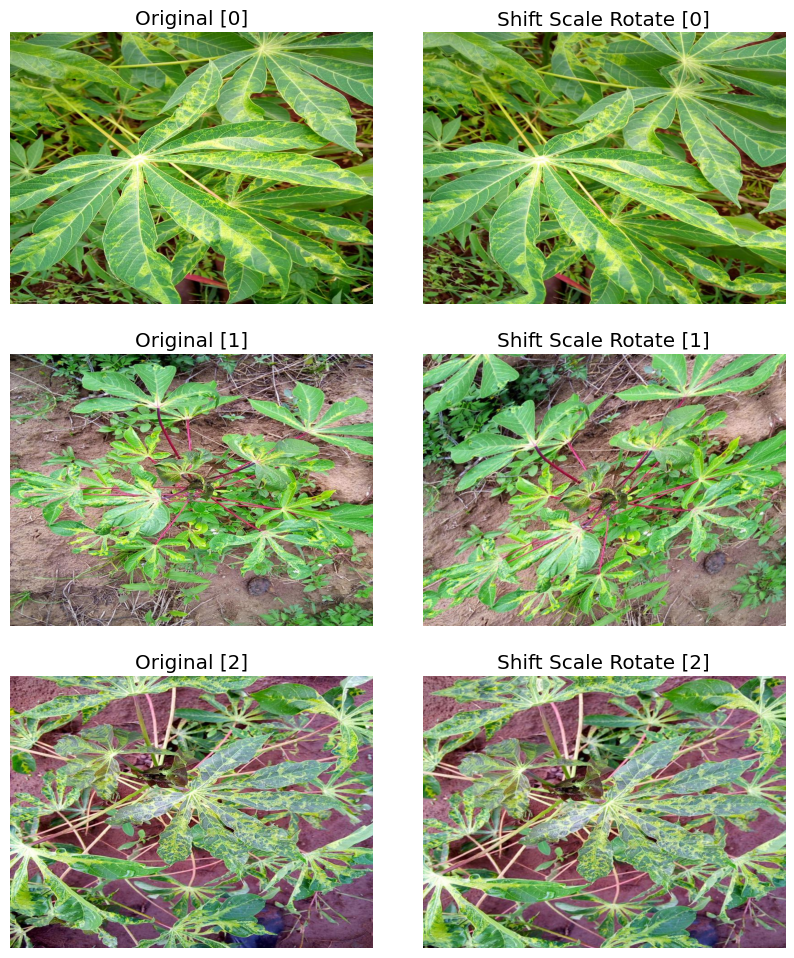

In [17]:
shift_scale_rotate_transform = albumentations.ShiftScaleRotate(p=1)

fig = plt.figure(figsize=(5 * 2, 5 * N))
grid = ImageGrid(fig, 111, nrows_ncols=(N, 2), axes_pad=0.5)
for i, ax in enumerate(grid):
    # Random new sample
    if i % 2 == 0:
        org_img = plt.imread(paths[i // 2])
        img = org_img.copy()
        ax.imshow(img)
        ax.set_title(f'Original [{i // 2}]')
    else:
        img = shift_scale_rotate_transform(image=img)['image']
        ax.imshow(img)
        ax.set_title(f'Shift Scale Rotate [{i // 2}]')
    
    ax.axis('off')

## 3.7 Hue Saturation Value Transform

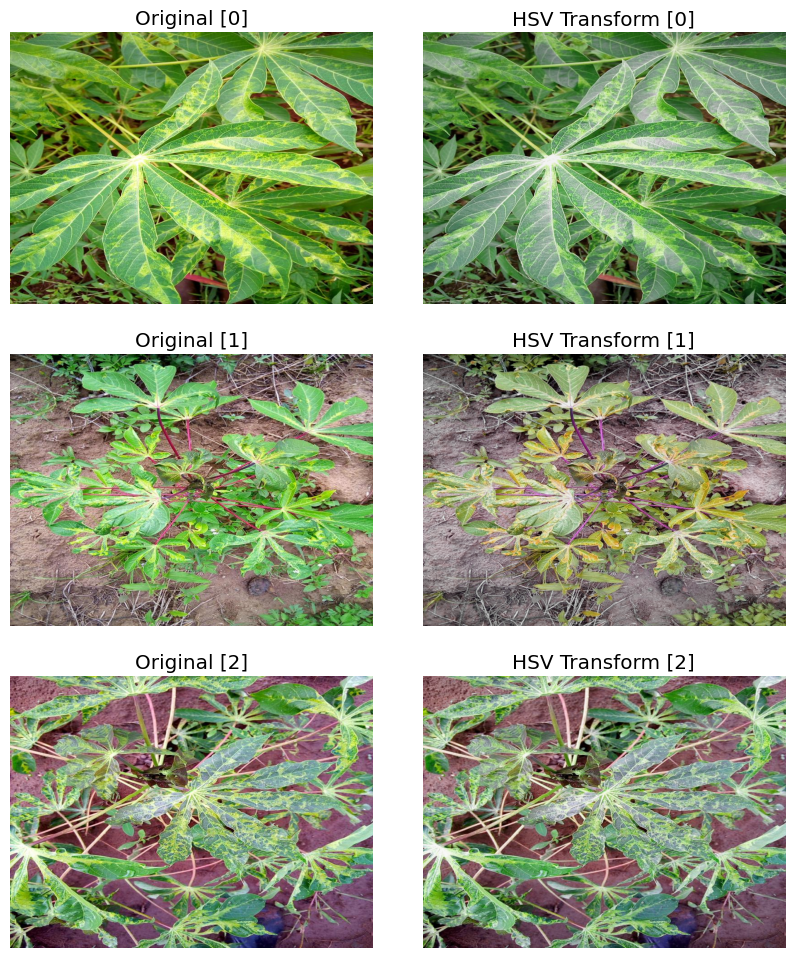

In [18]:
hue_saturation_value_transform = albumentations.HueSaturationValue(
    hue_shift_limit=20,
    sat_shift_limit=50,
    val_shift_limit=20,
    p=1)

fig = plt.figure(figsize=(5 * 2, 5 * N))
grid = ImageGrid(fig, 111, nrows_ncols=(N, 2), axes_pad=0.5)
for i, ax in enumerate(grid):
    # Random new sample
    if i % 2 == 0:
        org_img = plt.imread(paths[i // 2])
        img = org_img.copy()
        ax.imshow(img)
        ax.set_title(f'Original [{i // 2}]')
    else:
        img = hue_saturation_value_transform(image=img)['image']
        ax.imshow(img)
        ax.set_title(f'HSV Transform [{i // 2}]')
    
    ax.axis('off')

## 3.8 Random Brightness Contrast

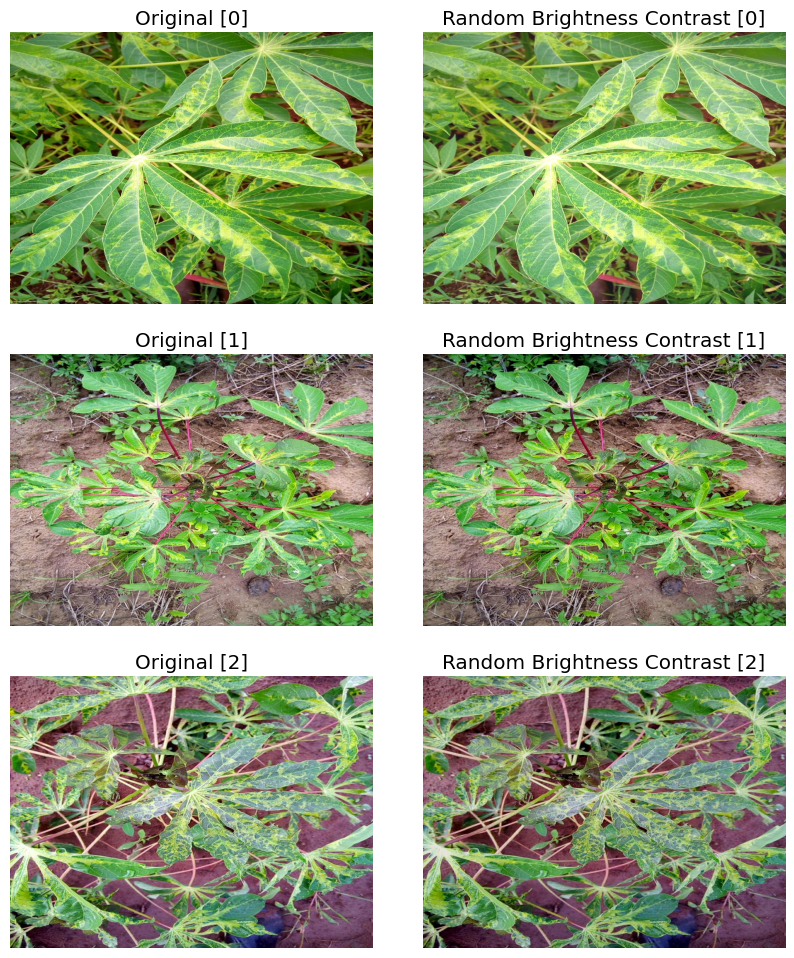

In [19]:
random_brightness_contrast_transform = albumentations.RandomBrightnessContrast(
    brightness_limit=(-0.1, 0.1), 
    contrast_limit=(-0.1, 0.1), 
    p=1)

fig = plt.figure(figsize=(5 * 2, 5 * N))
grid = ImageGrid(fig, 111, nrows_ncols=(N, 2), axes_pad=0.5)
for i, ax in enumerate(grid):
    # Random new sample
    if i % 2 == 0:
        org_img = plt.imread(paths[i // 2])
        img = org_img.copy()
        ax.imshow(img)
        ax.set_title(f'Original [{i // 2}]')
    else:
        img = random_brightness_contrast_transform(image=img)['image']
        ax.imshow(img)
        ax.set_title(f'Random Brightness Contrast [{i // 2}]')
    
    ax.axis('off')

# 4. Modeling

In [20]:
WIDTH = 512
HEIGHT = 512
NUM_CLASSES = 5
BATCH_SIZE = 32
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
print(f'Device: {DEVICE}')

Device: cuda


In [21]:
train_transforms = albumentations.Compose([
    
    albumentations.RandomResizedCrop(WIDTH, HEIGHT),
    albumentations.HorizontalFlip(p=0.5),
    albumentations.Transpose(p=0.5),
    albumentations.VerticalFlip(p=0.5),
    albumentations.ShiftScaleRotate(p=0.5),
    albumentations.HueSaturationValue(
                hue_shift_limit=0.2, 
                sat_shift_limit=0.2, 
                val_shift_limit=0.2, 
                p=0.5
            ),
    albumentations.RandomBrightnessContrast(
                brightness_limit=(-0.1, 0.1), 
                contrast_limit=(-0.1, 0.1), 
                p=0.5),
    albumentations.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
    ToTensorV2()
    
])

test_transforms = albumentations.Compose([
    albumentations.CenterCrop(WIDTH, HEIGHT, p=1.0),
    albumentations.Resize(WIDTH, HEIGHT),
    albumentations.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
    ToTensorV2(),
])

In [22]:
class CassavaDataset(Dataset):
    
    def __init__(self, df, transform=None):
        self.df = df
        self.transform = transform
        
    def __len__(self):
        return len(self.df)
    
    def __getitem__(self, index):
        
        img = Image.open(self.df['path'][index])
        img = np.array(img)
        label = torch.tensor(self.df['label'][index], dtype=torch.long)
        
        if self.transform:
            return self.transform(image=img)['image'], label 
        else:
            return img, label 

In [23]:
train_dataset = CassavaDataset(train_df, transform=train_transforms)
val_dataset = CassavaDataset(val_df, transform=test_transforms)
test_dataset = CassavaDataset(test_df, transform=test_transforms)

train_dl = DataLoader(train_dataset, BATCH_SIZE, shuffle=True)
val_dl = DataLoader(val_dataset, BATCH_SIZE, shuffle=True)
test_dl = DataLoader(test_dataset, BATCH_SIZE, shuffle=True)

In [24]:
def get_resnet_model():
    
    model = models.resnet50(weights=models.ResNet50_Weights.DEFAULT)
    
    for params in model.parameters():
        params.requires_grad = False
        
    in_feat = model.fc.in_features
        
    model.fc = nn.Sequential(
          nn.Linear(in_feat, 256),
          nn.ReLU(),
          nn.Dropout(p=0.3),
          nn.Linear(256, NUM_CLASSES))
    
    model = model.to(DEVICE)
    
    return model

Model summary

In [25]:
model = get_resnet_model()

summary(model, input_size=(BATCH_SIZE, 3, WIDTH, HEIGHT))

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 147MB/s]


Layer (type:depth-idx)                   Output Shape              Param #
ResNet                                   [32, 5]                   --
├─Conv2d: 1-1                            [32, 64, 256, 256]        (9,408)
├─BatchNorm2d: 1-2                       [32, 64, 256, 256]        (128)
├─ReLU: 1-3                              [32, 64, 256, 256]        --
├─MaxPool2d: 1-4                         [32, 64, 128, 128]        --
├─Sequential: 1-5                        [32, 256, 128, 128]       --
│    └─Bottleneck: 2-1                   [32, 256, 128, 128]       --
│    │    └─Conv2d: 3-1                  [32, 64, 128, 128]        (4,096)
│    │    └─BatchNorm2d: 3-2             [32, 64, 128, 128]        (128)
│    │    └─ReLU: 3-3                    [32, 64, 128, 128]        --
│    │    └─Conv2d: 3-4                  [32, 64, 128, 128]        (36,864)
│    │    └─BatchNorm2d: 3-5             [32, 64, 128, 128]        (128)
│    │    └─ReLU: 3-6                    [32, 64, 128, 128] 

In [26]:
def train(model, num_epochs, train_dl, valid_dl):
    
    loss_hist_train = [0] * num_epochs
    accuracy_hist_train = [0] * num_epochs
    loss_hist_valid = [0] * num_epochs
    accuracy_hist_valid = [0] * num_epochs
    
    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0
    min_valid_loss = np.inf
    
    for epoch in range(num_epochs):
        
        model.train()
        
        batch_num = 0
        
        for x_batch, y_batch in tqdm(train_dl):
            
            x_batch = x_batch.to(DEVICE)
            y_batch = y_batch.to(DEVICE)
            
            batch_num += 1
            #if (batch_num % 100 == 0):
                #print(f'Batch number: {batch_num}')
            
            pred = model(x_batch)
            loss = loss_fn(pred, y_batch)
            loss.backward()
            optimizer.step()
            optimizer.zero_grad()
            
            loss_hist_train[epoch] += loss.item() * y_batch.size(0)
            is_correct = (torch.argmax(pred, dim=1) == y_batch).float()
            accuracy_hist_train[epoch] += is_correct.sum().item()
        
        
        loss_hist_train[epoch] /= len(train_dl.dataset)
        accuracy_hist_train[epoch] /= len(train_dl.dataset)
        
        scheduler.step()
        
        model.eval()
        
        with torch.no_grad():
            
            for x_batch, y_batch in valid_dl:
                
                x_batch = x_batch.to(DEVICE)
                y_batch = y_batch.to(DEVICE)
                
                pred = model(x_batch)
                loss = loss_fn(pred, y_batch)
                loss_hist_valid[epoch] += loss.item() * y_batch.size(0)
                is_correct = (torch.argmax(pred, dim=1) == y_batch).float()
                accuracy_hist_valid[epoch] += is_correct.sum().item()
                
        loss_hist_valid[epoch] /= len(valid_dl.dataset)
        accuracy_hist_valid[epoch] /= len(valid_dl.dataset)
        
        if accuracy_hist_valid[epoch] > best_acc:
            best_acc = accuracy_hist_valid[epoch]
            best_model_wts = copy.deepcopy(model.state_dict())
        
        print(f'Epoch {epoch+1}:   Train accuracy: {accuracy_hist_train[epoch]:.4f}    Validation accuracy: {accuracy_hist_valid[epoch]:.4f} ')
    
    
        if loss_hist_valid[epoch] < min_valid_loss:
            counter = 0
        else:
            counter += 1
    
        if counter >= patience:
            break
    
    
    model.load_state_dict(best_model_wts)
    
    history = {}
    history['loss_hist_train'] = loss_hist_train
    history['loss_hist_valid'] = loss_hist_valid
    history['accuracy_hist_train'] = accuracy_hist_train
    history['accuracy_hist_valid'] = accuracy_hist_valid
    
    return model, history

In [27]:
num_epochs = 10
patience = 3
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(optimizer, T_0=10, T_mult=1, eta_min=1e-6, last_epoch=-1)

Train model

In [28]:
best_model, hist = train(model, num_epochs, train_dl, val_dl)

100%|██████████| 402/402 [05:04<00:00,  1.32it/s]


Epoch 1:   Train accuracy: 0.6871    Validation accuracy: 0.7441 


100%|██████████| 402/402 [04:54<00:00,  1.36it/s]


Epoch 2:   Train accuracy: 0.7459    Validation accuracy: 0.7665 


100%|██████████| 402/402 [04:54<00:00,  1.36it/s]


Epoch 3:   Train accuracy: 0.7615    Validation accuracy: 0.7787 


100%|██████████| 402/402 [04:55<00:00,  1.36it/s]


Epoch 4:   Train accuracy: 0.7666    Validation accuracy: 0.7901 


100%|██████████| 402/402 [04:56<00:00,  1.35it/s]


Epoch 5:   Train accuracy: 0.7740    Validation accuracy: 0.7766 


100%|██████████| 402/402 [04:57<00:00,  1.35it/s]


Epoch 6:   Train accuracy: 0.7783    Validation accuracy: 0.7936 


100%|██████████| 402/402 [04:51<00:00,  1.38it/s]


Epoch 7:   Train accuracy: 0.7837    Validation accuracy: 0.7995 


100%|██████████| 402/402 [04:53<00:00,  1.37it/s]


Epoch 8:   Train accuracy: 0.7909    Validation accuracy: 0.7939 


100%|██████████| 402/402 [04:53<00:00,  1.37it/s]


Epoch 9:   Train accuracy: 0.7987    Validation accuracy: 0.7962 


100%|██████████| 402/402 [04:55<00:00,  1.36it/s]


Epoch 10:   Train accuracy: 0.7908    Validation accuracy: 0.7971 


# 5. Evaluation

In [29]:
label_list = []
prediction_list = []

with torch.no_grad():
    for image, label in tqdm(test_dl):
        
        image = image.to(DEVICE)
        logits = best_model(image)
        probs = torch.nn.functional.softmax(logits, dim=1).detach().cpu().numpy()
        prediction = np.argmax(probs, axis=1)
        label_list += label.numpy().tolist()
        prediction_list += prediction.tolist()

100%|██████████| 134/134 [01:16<00:00,  1.74it/s]


In [30]:
print(classification_report(label_list, prediction_list))

              precision    recall  f1-score   support

           0       0.51      0.30      0.37       210
           1       0.62      0.65      0.64       443
           2       0.70      0.58      0.63       455
           3       0.91      0.94      0.92      2649
           4       0.58      0.66      0.61       522

    accuracy                           0.80      4279
   macro avg       0.66      0.62      0.64      4279
weighted avg       0.80      0.80      0.80      4279



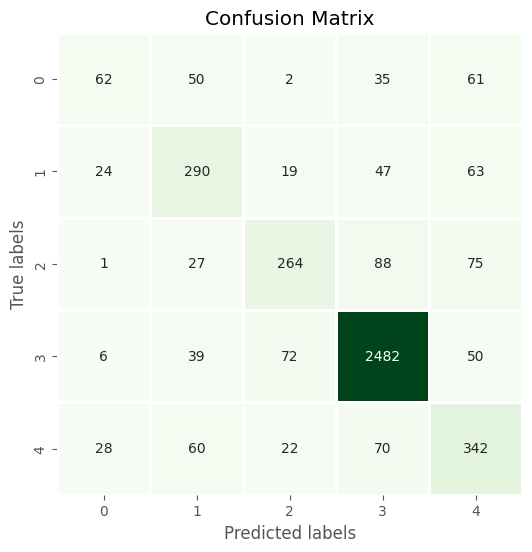

In [31]:
cm = confusion_matrix(label_list, prediction_list)
plt.figure(figsize=(6, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Greens', cbar=False, linewidth=1, linecolor='white')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.show()